In [5]:
from transformers import SegformerImageProcessor, AutoModelForSemanticSegmentation
from PIL import Image
import requests
import matplotlib.pyplot as plt
import torch.nn as nn

processor = SegformerImageProcessor.from_pretrained("mattmdjaga/segformer_b2_clothes")
model = AutoModelForSemanticSegmentation.from_pretrained("mattmdjaga/segformer_b2_clothes")

In [14]:
url = "https://static.zara.net/photos///2024/V/0/1/p/4661/005/800/2/w/2048/4661005800_1_1_1.jpg?ts=1706628794635"

def seg(url):
    image = Image.open(requests.get(url, stream=True).raw)
    inputs = processor(images=image, return_tensors="pt")

    outputs = model(**inputs)
    logits = outputs.logits.cpu()

    upsampled_logits = nn.functional.interpolate(
        logits,
     size=image.size[::-1],
        mode="bilinear",
        align_corners=False,
    )

    pred_seg = upsampled_logits.argmax(dim=1)[0]

    f, axarr = plt.subplots(1, 2)

    axarr[0].imshow(image)
    axarr[1].imshow(pred_seg)

    for i in range(2):
            axarr[i].get_xaxis().set_visible(False)
            axarr[i].get_yaxis().set_visible(False)

    plt.show()

In [20]:
image = Image.open(requests.get(url, stream=True).raw)
inputs = processor(images=image, return_tensors="pt")

outputs = model(**inputs)
logits = outputs.logits.cpu()

upsampled_logits = nn.functional.interpolate(
    logits,
    size=image.size[::-1],
    mode="bilinear",
    align_corners=False,
)

pred_seg = upsampled_logits.argmax(dim=1)[0]

In [24]:
inputs

{'pixel_values': tensor([[[[1.8550, 1.8550, 1.8550,  ..., 1.7694, 1.7694, 1.7694],
          [1.8550, 1.8550, 1.8550,  ..., 1.7694, 1.7694, 1.7694],
          [1.8550, 1.8550, 1.8550,  ..., 1.7694, 1.7694, 1.7694],
          ...,
          [1.8550, 1.8550, 1.8550,  ..., 1.6838, 1.6838, 1.6838],
          [1.8550, 1.8550, 1.8550,  ..., 1.6838, 1.6838, 1.6838],
          [1.8550, 1.8550, 1.8550,  ..., 1.7009, 1.7009, 1.7009]],

         [[2.0084, 2.0084, 2.0084,  ..., 1.9559, 1.9559, 1.9559],
          [2.0084, 2.0084, 2.0084,  ..., 1.9559, 1.9559, 1.9559],
          [2.0084, 2.0084, 2.0084,  ..., 1.9559, 1.9559, 1.9559],
          ...,
          [2.0259, 2.0259, 2.0259,  ..., 1.9034, 1.9034, 1.9034],
          [2.0259, 2.0259, 2.0259,  ..., 1.9034, 1.9034, 1.9034],
          [2.0259, 2.0259, 2.0259,  ..., 1.9209, 1.9209, 1.9209]],

         [[2.3088, 2.3088, 2.3088,  ..., 2.2391, 2.2391, 2.2391],
          [2.3088, 2.3088, 2.3088,  ..., 2.2391, 2.2391, 2.2391],
          [2.3088, 2.3088

In [23]:
outputs

SemanticSegmenterOutput(loss=None, logits=tensor([[[[ 7.1383,  7.2015,  7.2590,  ...,  7.5881,  7.6714,  8.0334],
          [ 7.1561,  7.2300,  7.3571,  ...,  8.0213,  8.3815,  8.6941],
          [ 7.1396,  7.1307,  7.1842,  ...,  7.8385,  7.9704,  8.4622],
          ...,
          [ 7.7140,  8.0826,  7.7658,  ...,  7.8488,  8.1953,  8.8024],
          [ 7.9609,  8.4452,  7.9835,  ...,  8.2244,  8.5253,  9.1546],
          [ 8.1906,  8.6335,  8.3382,  ...,  8.5659,  8.8825,  9.3065]],

         [[-6.8331, -7.1574, -6.8377,  ..., -5.5589, -5.7516, -6.5040],
          [-7.0110, -8.2013, -7.5841,  ..., -6.4319, -6.6139, -7.4381],
          [-6.6411, -7.2907, -6.7945,  ..., -5.5578, -5.6973, -6.3201],
          ...,
          [-5.3754, -5.9834, -5.3394,  ..., -5.3873, -5.5646, -6.1615],
          [-5.6382, -6.1636, -5.4168,  ..., -5.5751, -5.7084, -6.2675],
          [-6.0508, -6.2889, -5.8579,  ..., -5.8164, -5.9371, -6.2962]],

         [[-4.9442, -5.1917, -4.9573,  ..., -4.7867, -4.9288

In [40]:
upsampled_logits.shape

torch.Size([1, 18, 3072, 2048])

In [43]:
upsampled_logits[0][0].shape

torch.Size([3072, 2048])

In [41]:
pred_seg.shape

torch.Size([3072, 2048])

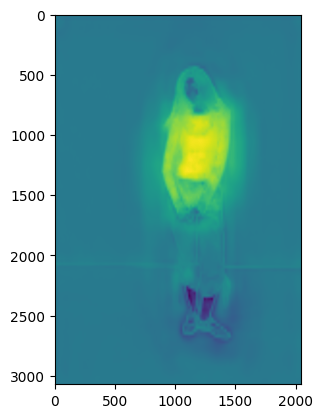

In [48]:
plt.imshow(upsampled_logits[0][4].detach().numpy())

In [82]:
def get_seg(image, idx):
    image = [[int(x == idx) for x in y] for y in image]
    return image

In [83]:
pred_segg = pred_seg.numpy(force = True)

In [84]:
pred_segg.shape

(3072, 2048)

In [85]:
pred_seg[1500][1000].item()

4

In [86]:
get_seg(pred_segg, 0)

[[1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,


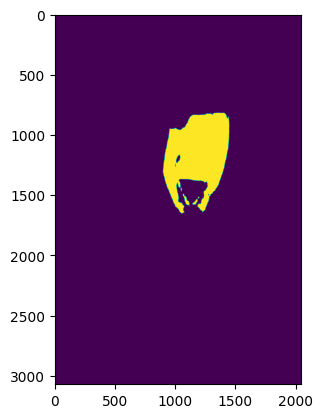

In [89]:
plt.imshow(get_seg(pred_segg, 4))

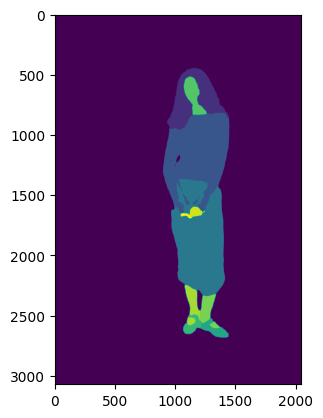

In [42]:
plt.imshow(pred_seg)

In [28]:
logits.shape

torch.Size([1, 18, 128, 128])

In [32]:
pred_seg.shape

torch.Size([3072, 2048])

In [35]:
upsampled_logits.argmax(dim = 1)[0].shape

torch.Size([3072, 2048])

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

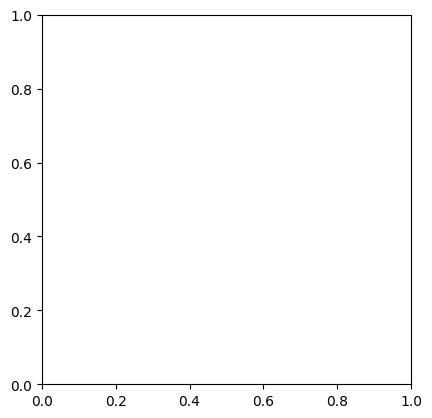

In [38]:
plt.imshow(upsampled_logits[0][0])

In [27]:
upsampled_logits.shape

torch.Size([1, 18, 3072, 2048])

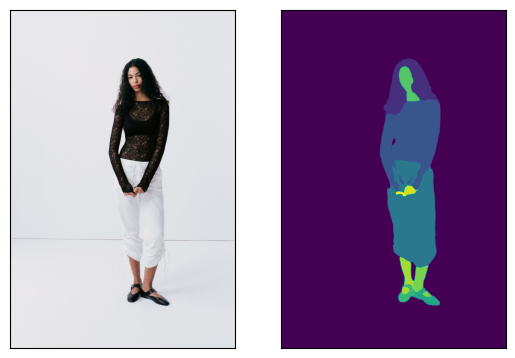

In [16]:
seg("https://static.zara.net/photos///2024/V/0/1/p/4661/005/800/2/w/2048/4661005800_1_1_1.jpg?ts=1706628794635")

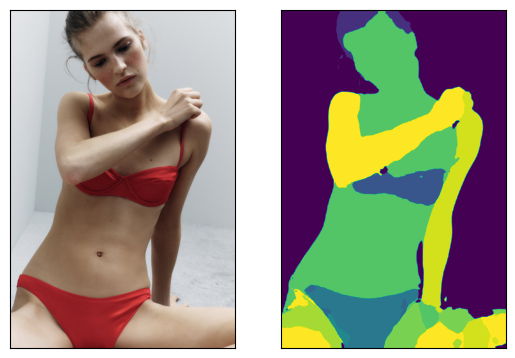

In [17]:
seg("https://static.zara.net/photos///2024/V/0/1/p/1228/801/600/2/w/2048/1228801600_1_1_1.jpg?ts=1706871260493")

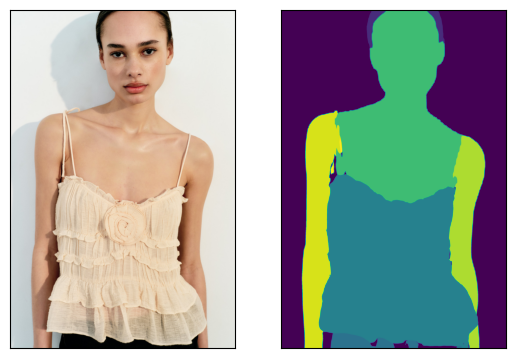

In [18]:
seg("https://static.zara.net/photos///2024/V/0/1/p/7521/029/727/2/w/2048/7521029727_2_1_1.jpg?ts=1711118881977")

In [13]:
pred_seg.shape

torch.Size([3072, 2048])

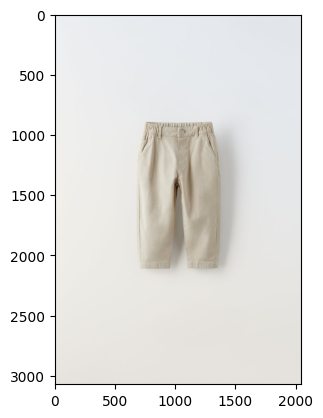

In [8]:
plt.imshow(image)